# Quickly check equivital signal information 
at specific time points, according to date times.

Choose point to folder with recordings and specify PartID, start datetime and stop datetime

get back either: "these measurements do not exists" or a plot

Plot:
 1. QoM ACC
 2. IBI and median IBI (HR?)
 3. Resp wave
 

In [2]:
import sys
import os
import time
import datetime as dt
import math
import numpy as np 
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import json 
import librosa
from IPython.display import Audio
import mir_eval.sonify

from scipy.signal import butter, filtfilt, argrelextrema
from scipy import interpolate
from scipy.interpolate import interp1d

In [3]:
%load_ext autoreload
%autoreload 1
%aimport qex
%aimport al
%aimport eq

In [4]:
 %reload_ext autoreload

In [5]:
# audio file locations in
datadir = '../Data2024/'
# audio_loc = '../Data2024/Audio/Full_Zero/'
audio_loc = '../Data2024/Audio/Piece_wise/'
# audio file locations out
Event_timings  = pd.read_csv(datadir + 'Timing/Lydo2024_DayEvents.csv',index_col = 0)
Event_timings['dTime_start'] = pd.to_datetime(Event_timings['dTime_start'])
Event_timings['dTime_end'] = pd.to_datetime(Event_timings['dTime_end'])

Piece_timings  = pd.read_csv(datadir + 'Timing/Lydo2024_Performance_events_red.csv')
Piece_timings

,Event,Related,Event_Type,Full_Title,Composer,Performer,Screen,RD,C1,C2,C3,C4,C5,C6,C7
0,Tuning,Conc,Music,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000,0.000000,0.000000,0.000000,0.000000,0.000000
1,Marsj,Trad,Music,Gammel Jegermarsj,arr. Frederik Schöildberg (?),NaN,NaN,589.203333,45.320000,41.868,46.013333,42.478500,48.032000,41.860000,43.392000
2,MC,Trad,Speech,NaN,NaN,NaN,NaN,606.933333,63.086667,59.780,64.253333,60.690000,65.960000,59.901333,61.077333
3,Ringe,Intr,Music,NaN,NaN,NaN,NaN,612.912000,77.263333,88.020,76.248667,74.331000,79.840000,73.653333,75.242667
4,MC,Intr,Speech,NaN,NaN,NaN,NaN,615.216000,82.033333,93.982,81.013333,79.189333,85.168000,77.888000,79.914667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61,MC,Ross,Speech,NaN,NaN,NaN,NaN,3334.570667,2738.355000,2740.158,2704.221000,2675.220000,2632.998667,2644.581333,2765.760000
62,Wilhelm Tell,Ross,Music,Guillaume Tell Ouverture,Gioachino Rossino,NaN,NaN,3340.416000,2744.637000,2746.438,2711.202000,2680.788000,2639.896000,2650.144000,2770.816000
63,Applause,Ross,Applause,NaN,NaN,NaN,NaN,3738.709333,3149.079000,3142.804,3122.261333,3084.543000,3036.590667,3043.656000,3164.588000
64,MC,Conc,Speech,NaN,NaN,NaN,NaN,3746.026667,3164.244000,3161.904,3139.650000,3102.421333,3056.760000,3064.002667,NaN


In [6]:
Event_timings

,dTime_start,rTime_start,cTime_start,dTime_end,rTime_end,cTime_end,Equivitals,Audio,Video,IR,Note
Event,,,,,,,,,,,
Sync1_04,2024-03-04 07:56:23.762800000,285.762812,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Sync2_04,2024-03-04 14:25:45.464600000,23647.464610,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Sync1_05,2024-03-05 07:42:22.272471655,8.272472,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
RD,2024-03-05 10:37:53.882999655,10539.883000,0.0,2024-03-05 11:40:26.296999655,14292.297,3752.414,NaN,NaN,122.940,NaN,NaN
Sync2_05,2024-03-05 13:52:59.859163265,22245.859160,0.0,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Sync3_05,2024-03-05 15:30:14.852841270,28080.852840,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Sync1_06,2024-03-06 07:12:08.000000000,0.000000,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
C1,NaT,NaN,0.0,NaT,NaN,3182.218,NaN,NaN,-670.413,NaN,NaN
C2,NaT,NaN,0.0,NaT,NaN,3214.929,NaN,NaN,-197.432,NaN,NaN


In [45]:
concert = 'C3'
concert_start_dt = Event_timings.loc[concert,'dTime_start'] 
C_times = Piece_timings[['Event','Event_Type','Related']].copy()
C_times['Start'] =  Piece_timings[concert]
C_times = C_times.sort_values('Start')
C_times['Next'] = C_times.Start.shift(-1)
C_times['Start_dt'] = concert_start_dt + pd.to_timedelta(C_times['Start'],unit='s')
C_times['Next_dt'] = concert_start_dt + pd.to_timedelta(C_times['Next'],unit='s')
M_times =  C_times.loc[C_times['Event_Type'] == 'Music',:]
M_times.set_index('Related',drop = True,inplace = True)
M_times

,Event,Event_Type,Start,Next,Start_dt,Next_dt
Related,,,,,,
Conc,Tuning,Music,0.000000,46.013333,2024-03-07 08:34:57.517000000,2024-03-07 08:35:43.530333330
Trad,Marsj,Music,46.013333,64.253333,2024-03-07 08:35:43.530333330,2024-03-07 08:36:01.770333330
Intr,Ringe,Music,76.248667,81.013333,2024-03-07 08:36:13.765666670,2024-03-07 08:36:18.530333330
Newm,20thCFox,Music,143.038000,165.111333,2024-03-07 08:37:20.555000000,2024-03-07 08:37:42.628333300
Gre1,Morgenstemning,Music,193.410000,284.722667,2024-03-07 08:38:10.927000000,2024-03-07 08:39:42.239666700
Stra,Ildfuglen,Music,291.680667,388.808000,2024-03-07 08:39:49.197666700,2024-03-07 08:41:26.325000000
Verd,LaTraviata,Music,507.733333,731.868667,2024-03-07 08:43:25.250333300,2024-03-07 08:47:09.385666700
Saev,Kjempervisesåtten,Music,830.704000,1082.041333,2024-03-07 08:48:48.221000000,2024-03-07 08:52:59.558333000
Will,Hedvig,Music,1161.990667,1294.057333,2024-03-07 08:54:19.507667000,2024-03-07 08:56:31.574333000


### test excerpt and defn

In [112]:
data_dir='/Volumes/TaeTae/Stavangar/bic2024/'
sep = '/'
DATAtag='EQDATA'
df_datafiles = eq.eq_recordings(data_dir+'wed'+'/','EQDATA','/')
#df_datafiles.iloc[:5,:]

/Volumes/TaeTae/Stavangar/bic2024/wed/WW506_20240306_FULL_EQDATA.csv
/Volumes/TaeTae/Stavangar/bic2024/wed/WW508_20240306_FULL_EQDATA.csv
/Volumes/TaeTae/Stavangar/bic2024/wed/BR604_20240306_FULL_EQDATA.csv
/Volumes/TaeTae/Stavangar/bic2024/wed/BR609_20240306_FULL_EQDATA.csv
/Volumes/TaeTae/Stavangar/bic2024/wed/BR608_20240306_FULL_EQDATA.csv


In [91]:
concert = '20240306'
data_dir='/Volumes/TaeTae/Stavangar/bic2024/'
sep = '/'
DATAtag='EQDATA'
df_datafiles = eq.eq_recordings(data_dir+concert+'/','EQDATA','/')
df_datafiles.iloc[:5,:]

/Volumes/TaeTae/Stavangar/bic2024/20240306/WW506_20240306_FULL_EQDATA.csv
/Volumes/TaeTae/Stavangar/bic2024/20240306/._WW506_20240306_FULL_EQDATA.csv


UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb0 in position 37: invalid start byte

In [19]:
data_dir='/Volumes/SeagateHub/BiC2024_Synced/Equivital/FullDay/20240306/' 
sep = '/'
DATAtag='EQDATA'
df_datafiles = eq.eq_recordings(data_dir,'EQDATA','/')
#df_datafiles.iloc[:5,:]

In [47]:
df_datafiles.iloc[:10,:]

,Signal,PartID,ID,Date,Session,FileName,FileType,FileSize,RecStart,RecEnd,...,SubjectNames,SENSOR ID,SUBJECT ID,SUBJECT AGE,HR(BPM),HRC(%),BELT OFF,LEAD OFF,MOTION,BODY POSITION
0,DATA,VA305,[5022117],2024-03-07,C3,C3_FULL_VA305_EQDATA.csv,csv,24991,2024-03-07 08:34:42.762800,2024-03-07 09:27:43.011500,...,[VA305],5022117.0,VA305,53.0,70.0,97.0,0.0,0.0,Stationary,Upright
1,DATA,VN104,[3420456],2024-03-07,C3,C3_FULL_VN104_EQDATA.csv,csv,24523,2024-03-07 08:34:43.136800,2024-03-07 09:27:43.575200,...,[VN104],3420456.0,VN104,53.0,80.0,98.0,0.0,0.0,Stationary,Upright
2,DATA,LS409,[5022139],2024-03-07,C3,C3_FULL_LS409_EQDATA.csv,csv,25020,2024-03-07 08:34:43.683500,2024-03-07 09:27:43.916600,...,[LS409],5022139.0,LS409,53.0,62.0,97.0,0.0,0.0,Stationary,Upright
3,DATA,VN101,[3420415],2024-03-07,C3,C3_FULL_VN101_EQDATA.csv,csv,25397,2024-03-07 08:34:43.757500,2024-03-07 09:27:44.229800,...,[VN101],3420415.0,VN101,53.0,75.0,98.0,0.0,0.0,MovingSlowly,Upright
4,DATA,VN109,[5022010],2024-03-07,C3,C3_FULL_VN109_EQDATA.csv,csv,24986,2024-03-07 08:34:45.915800,2024-03-07 09:27:46.177500,...,[VN109],5022010.0,VN109,53.0,84.0,97.0,0.0,0.0,Stationary,Upright
5,DATA,WW506,[5022166],2024-03-07,C3,C3_FULL_WW506_EQDATA.csv,csv,25005,2024-03-07 08:34:46.033300,2024-03-07 09:27:46.293100,...,[WW506],5022166.0,WW506,53.0,83.0,98.0,0.0,0.0,Stationary,Upright
6,DATA,VN201,[5022050],2024-03-07,C3,C3_FULL_VN201_EQDATA.csv,csv,25017,2024-03-07 08:34:46.075200,2024-03-07 09:27:46.287400,...,[VN201],5022050.0,VN201,53.0,66.0,98.0,0.0,0.0,Stationary,Upright
7,DATA,WW508,[5022176],2024-03-07,C3,C3_FULL_WW508_EQDATA.csv,csv,25006,2024-03-07 08:34:46.544900,2024-03-07 09:27:46.774700,...,[WW508],5022176.0,WW508,53.0,86.0,97.0,0.0,0.0,Stationary,Upright
8,DATA,VN105,[3420755],2024-03-07,C3,C3_FULL_VN105_EQDATA.csv,csv,24371,2024-03-07 08:34:47.023300,2024-03-07 09:27:47.450700,...,[VN105],3420755.0,VN105,53.0,68.0,98.0,0.0,0.0,Stationary,Upright
9,DATA,VA309,[5022234],2024-03-07,C3,C3_FULL_VA309_EQDATA.csv,csv,24352,2024-03-07 08:34:47.298400,2024-03-07 09:27:47.538700,...,[VA309],5022234.0,VA309,53.0,76.0,99.0,0.0,0.0,Stationary,Upright


In [22]:
buff = 1
buff_dt = pd.to_timedelta(1,unit='s')
segtag =  'Conc'
time_start = M_times.loc[segtag,'Start_dt']#-buff_dt Start
time_end = M_times.loc[segtag,'Next_dt']+buff_dt
partID = 'WW506'


In [23]:
concert_start_dt = Event_timings.loc[concert,'dTime_start'] 

concert_start_dt 

NaT

In [189]:
concert = 'C3'
concert_start_dt = Event_timings.loc[concert,'dTime_start'] 
C_times = Piece_timings[['Event','Event_Type','Related']].copy()
C_times['Start'] =  Piece_timings[concert]
C_times = C_times.sort_values('Start')
C_times['Next'] = C_times.Start.shift(-1)
C_times['Start_dt'] = concert_start_dt + pd.to_timedelta(C_times['Start'],unit='s')
C_times['Next_dt'] = concert_start_dt + pd.to_timedelta(C_times['Next'],unit='s')
M_times =  C_times.loc[C_times['Event_Type'] == 'Music',:]
M_times.set_index('Related',drop = True,inplace = True)
M_times

,Event,Event_Type,Start,Next,Start_dt,Next_dt
Related,,,,,,
Conc,Tuning,Music,0.000000,46.013333,2024-03-07 08:34:57.517000000,2024-03-07 08:35:43.530333330
Trad,Marsj,Music,46.013333,64.253333,2024-03-07 08:35:43.530333330,2024-03-07 08:36:01.770333330
Intr,Ringe,Music,76.248667,81.013333,2024-03-07 08:36:13.765666670,2024-03-07 08:36:18.530333330
Newm,20thCFox,Music,143.038000,165.111333,2024-03-07 08:37:20.555000000,2024-03-07 08:37:42.628333300
Gre1,Morgenstemning,Music,193.410000,284.722667,2024-03-07 08:38:10.927000000,2024-03-07 08:39:42.239666700
Stra,Ildfuglen,Music,291.680667,388.808000,2024-03-07 08:39:49.197666700,2024-03-07 08:41:26.325000000
Verd,LaTraviata,Music,507.733333,731.868667,2024-03-07 08:43:25.250333300,2024-03-07 08:47:09.385666700
Saev,Kjempervisesåtten,Music,830.704000,1082.041333,2024-03-07 08:48:48.221000000,2024-03-07 08:52:59.558333000
Will,Hedvig,Music,1161.990667,1294.057333,2024-03-07 08:54:19.507667000,2024-03-07 08:56:31.574333000


In [26]:
V = pd.read_csv(req['BACCloc'],skipinitialspace=True)
V['rec_dTime']=pd.to_datetime(V['rec_dTime'])#.dt.tz_localize(None)
V_seg = V.query('rec_dTime<@time_end & rec_dTime>@time_start').copy()
# because ACC
V_seg.loc[:,'qom'] = np.sqrt(np.square(V_seg.loc[:,[ 'Vert Accelerometer','Lat Accelerometer','Long Accelerometer']].diff()).sum(axis=1))
V_seg


NameError: name 'req' is not defined

In [94]:
V = pd.read_csv(req['CIBIloc'],skipinitialspace=True)
V['rec_dTime']=pd.to_datetime(V['rec_dTime'])#.dt.tz_localize(None)
V_seg = V.query('rec_dTime<@time_end & rec_dTime>@time_start').copy()
V_seg

,c_sTime,Interbeat Interval (MS),rec_dTime,dev_dTime
2707,2002.3686,585,2024-03-07 10:48:39.872600,2024-03-07 10:48:38.183
2708,2002.9546,582,2024-03-07 10:48:40.458600,2024-03-07 10:48:38.769
2709,2003.5407,589,2024-03-07 10:48:41.044700,2024-03-07 10:48:39.355
2710,2004.1267,589,2024-03-07 10:48:41.630700,2024-03-07 10:48:39.941
2711,2004.7128,593,2024-03-07 10:48:42.216800,2024-03-07 10:48:40.527
...,...,...,...,...
2763,2028.5427,425,2024-03-07 10:49:06.046700,2024-03-07 10:49:04.355
2764,2029.0118,437,2024-03-07 10:49:06.515800,2024-03-07 10:49:04.824
2765,2029.4408,445,2024-03-07 10:49:06.944800,2024-03-07 10:49:05.253
2766,2029.9098,457,2024-03-07 10:49:07.413800,2024-03-07 10:49:05.722


In [95]:
V = pd.read_csv(req['RESPloc'],skipinitialspace=True)
V['rec_dTime']=pd.to_datetime(V['rec_dTime'])#.dt.tz_localize(None)
V_seg = V.query('rec_dTime<@time_end & rec_dTime>@time_start').copy()
V_seg

,c_sTime,Breathing,rec_dTime,dev_dTime
51639,2002.3296,503,2024-03-07 10:48:39.833600,2024-03-07 10:48:38.144
51640,2002.3686,503,2024-03-07 10:48:39.872600,2024-03-07 10:48:38.183
51641,2002.4076,504,2024-03-07 10:48:39.911600,2024-03-07 10:48:38.222
51642,2002.4466,504,2024-03-07 10:48:39.950600,2024-03-07 10:48:38.261
51643,2002.4856,504,2024-03-07 10:48:39.989600,2024-03-07 10:48:38.300
...,...,...,...,...
52360,2030.4959,506,2024-03-07 10:49:07.999900,2024-03-07 10:49:06.308
52361,2030.5349,503,2024-03-07 10:49:08.038900,2024-03-07 10:49:06.347
52362,2030.5739,501,2024-03-07 10:49:08.077900,2024-03-07 10:49:06.386
52363,2030.6129,499,2024-03-07 10:49:08.116900,2024-03-07 10:49:06.425


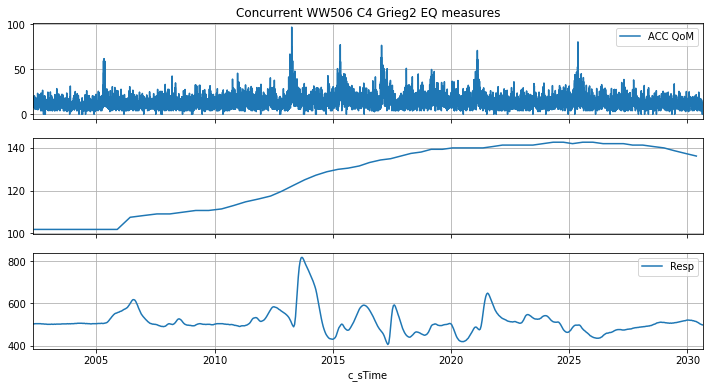

In [103]:
# plot all three
fig, axes = plt.subplots(4,1,figsize=(12,6),sharex = True)
time_c = 'c_sTime'
concert = 'C4'
piece = 'Grieg2'
ax = axes[0]
V = pd.read_csv(req['BACCloc'],skipinitialspace=True)
V['rec_dTime']=pd.to_datetime(V['rec_dTime'])#.dt.tz_localize(None)
V_seg = V.query('rec_dTime<@time_end & rec_dTime>@time_start').copy()
# because ACC
V_seg.loc[:,'qom'] = np.sqrt(np.square(V_seg.loc[:,[ 'Vert Accelerometer','Lat Accelerometer','Long Accelerometer']].diff()).sum(axis=1))
V_seg.plot(x=time_c,y='qom',label='ACC QoM',ax=ax)
ax.grid()
ax = axes[1]
V = pd.read_csv(req['CIBIloc'],skipinitialspace=True)
V['rec_dTime']=pd.to_datetime(V['rec_dTime'])#.dt.tz_localize(None)
V_seg = V.query('rec_dTime<@time_end & rec_dTime>@time_start').copy()
sig_t = V_seg['c_sTime']
sig_v = V_seg['Interbeat Interval (MS)']
sig_v =sig_v.mask(sig_v.diff().abs()>120)
sig_v =sig_v.mask(sig_v<300)
min_per = 5
HR = (60000/sig_v).rolling(10,center=True,min_periods=min_per).median() # really lazy smoothing
ax.plot(sig_t,HR)
ax.grid()
#V_seg.plot(x=time_c,y='Interbeat Interval (MS)',label='IBI',ax=ax)
ax = axes[2]
V = pd.read_csv(req['RESPloc'],skipinitialspace=True)
V['rec_dTime']=pd.to_datetime(V['rec_dTime'])#.dt.tz_localize(None)
V_seg = V.query('rec_dTime<@time_end & rec_dTime>@time_start').copy()
V_seg.plot(x=time_c,y='Breathing',label='Resp',ax=ax)
ax.set_xlim([V_seg.iloc[0,0],V_seg.iloc[-1,0]])
ax.grid()
axes[0].set_title(' '.join(['Concurrent',partID,concert,piece,'EQ measures']))
plt.show()

# quick cut

In [27]:
def phys_cut(filelocs,partID,time_start,time_end,time_col = 'c_sTime'):
    df_datafiles = eq.eq_recordings(filelocs,'EQDATA','/')
    print(len(df_datafiles))
    rec_dets = df_datafiles.query('RecStart<@time_end & RecEnd>@time_start & PartID==@partID')
    if len(rec_dets)<1:
        print('No files')
        return []
    else:
        if len(rec_dets)>1:
            print('taking first of:')
            print(rec_dets)
        req = rec_dets.iloc[0,:]

        sigs = {}
    
        V = pd.read_csv(req['BACCloc'],skipinitialspace=True)
        V['rec_dTime']=pd.to_datetime(V['rec_dTime'])#.dt.tz_localize(None)
        V_seg = V.query('rec_dTime<@time_end & rec_dTime>@time_start').copy()
        # because ACC
        V_seg.loc[:,'qom'] = np.sqrt(np.square(V_seg.loc[:,[ 'Vert Accelerometer','Lat Accelerometer','Long Accelerometer']].diff()).sum(axis=1))
        sigs['ACC'] = V_seg
        
        V = pd.read_csv(req['CIBIloc'],skipinitialspace=True)
        V['rec_dTime']=pd.to_datetime(V['rec_dTime'])#.dt.tz_localize(None)
        V_seg = V.query('rec_dTime<@time_end & rec_dTime>@time_start').copy()
        sig_t = V_seg[time_col]
        sig_v = V_seg['Interbeat Interval (MS)']
        sig_v =sig_v.mask(sig_v.diff().abs()>120)
        sig_v =sig_v.mask(sig_v<300)
        min_per = 5
        V_seg['HR_10bt'] = (60000/sig_v).rolling(10,center=True,min_periods=min_per).median() # really lazy smoothing
        sigs['Cardio'] = V_seg
        
        V = pd.read_csv(req['RESPloc'],skipinitialspace=True)
        V['rec_dTime']=pd.to_datetime(V['rec_dTime'])#.dt.tz_localize(None)
        V_seg = V.query('rec_dTime<@time_end & rec_dTime>@time_start').copy()
        sigs['Resp'] = V_seg
        
        return sigs

In [28]:
# Event_timings

In [32]:
concert = 'C1'
data_dir='/Volumes/SeagateHub/BiC2024_Synced/Equivital/FullDay/20240306/' 

df_datafiles = eq.eq_recordings(data_dir,'EQDATA','/')
concert_start_dt = Event_timings.loc[concert,'dTime_start'] 

In [34]:
# concert_start_dt = Event_timings.loc[concert,'dTime_start'] 
C_times = Piece_timings[['Event','Event_Type','Related']].copy()
C_times['Start'] =  Piece_timings[concert]
C_times = C_times.sort_values('Start')
C_times['Next'] = C_times.Start.shift(-1)
C_times['Start_dt'] = concert_start_dt + pd.to_timedelta(C_times['Start'],unit='s')
C_times['Next_dt'] = concert_start_dt + pd.to_timedelta(C_times['Next'],unit='s')
M_times =  C_times.loc[C_times['Event_Type'] == 'Music',:]
M_times.set_index('Related',drop = True,inplace = True)
# M_times

In [35]:
M_times.index

Index(['Conc', 'Trad', 'Intr', 'Newm', 'Gre1', 'Stra', 'Verd', 'Saev', 'Will',
       'LieV', 'Izab', 'Gri2', 'Pend', 'Barb', 'Viva', 'Ros1', 'Ros2', 'Ros3',
       'Ros4', 'Ros5', 'Ros6', 'Ros7', 'Ross'],
      dtype='object', name='Related')

In [36]:
buff = 1
buff_dt = pd.to_timedelta(1,unit='s')
segtag ='Ros5'#'Ross' #'Newm' #'Ros5'
time_start = M_times.loc[segtag,'Start_dt']-buff_dt
#time_start = M_times.loc[segtag,'Start_dt']
time_end = M_times.loc[segtag,'Next_dt']+buff_dt
partID = 'WW508'
aud_file = audio_loc + '_'.join([concert,segtag,str(buff)+'.mp3'])
y, sr = librosa.load(aud_file)
rms =librosa.feature.rms(y=y, frame_length=256, hop_length=64, center=True, pad_mode='constant')
times = librosa.times_like(rms,sr = sr, hop_length=64)
rms_sf = int(sr/64)
aud_df = pd.DataFrame(index = times + M_times.loc[segtag,'Start']-buff)
aud_df['rms'] = rms[0]
Audio(data=y, rate=sr)

30
No files


TypeError: list indices must be integers or slices, not str

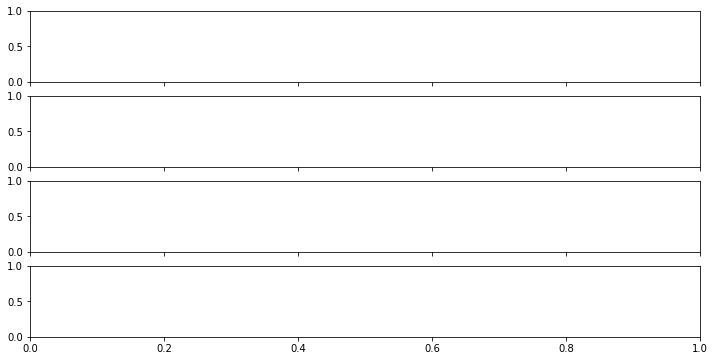

In [38]:
# plot all three
# segtag = 'tunesearch1'
fig, axes = plt.subplots(4,1,figsize=(12,6),sharex = True)
for pid in ['WW506','WW508']: #,'BR604','BR608','BR609']: #df_datafiles['PartID']:
    segs = phys_cut(data_dir,pid,time_start,time_end,'c_sTime') #+concert+'/'

    time_c = 'c_sTime'#
    ax = axes[0]
    V_seg = segs['ACC']
    V_seg.plot(x=time_c,y='qom',label=pid,ax=ax,legend = False)
    ax.grid()
    ax = axes[1]
    V_seg = segs['Cardio']
    V_seg.plot(x=time_c,y='HR_10bt',ax=ax,legend = False) #label=pid,
    ax.grid()
    #V_seg.plot(x=time_c,y='Interbeat Interval (MS)',label='IBI',ax=ax)
    ax = axes[2]
    V_seg = segs['Resp']
    V_seg['Breathing'] = V_seg['Breathing'].diff()# -V_seg['Breathing'].median()#
    V_seg.plot(x=time_c,y='Breathing',ax=ax,legend = False)# label=pid,
    ax.grid()
# ax.legend()
time0 = V_seg[time_c].iloc[0]
ax = axes[3]
aud_df.index = aud_df.index - aud_df.index[0] + time0
aud_df.plot(y='rms',label='Audio',ax=ax)
ax.set_title(concert_start_dt)
ax.set_xlim([V_seg.iloc[0,0],V_seg.iloc[-1,0]])
ax.grid()
ax.set_xticks(np.arange(int(V_seg.iloc[0,0]),int(V_seg.iloc[-1,0])))
axes[0].set_title(' '.join(['Concurrent',partID,concert,segtag,'EQ measures']))
plt.savefig('_'.join(['./plots/Concurrent','set',concert,segtag,'check.png']),bbox_inches = 'tight',dpi = 200)

plt.show()

In [841]:
print([partID,time_start,time_end])
df_datafiles.loc[:5,:]

['WW508', Timestamp('2024-03-07 09:20:07.719000'), Timestamp('2024-03-07 09:27:00.778332999')]


,Signal,PartID,ID,Date,Session,FileName,FileType,FileSize,RecStart,RecEnd,...,SubjectNames,SENSOR ID,SUBJECT ID,SUBJECT AGE,HR(BPM),HRC(%),BELT OFF,LEAD OFF,MOTION,BODY POSITION
0,DATA,VA305,[5022117],2024-03-07,C3,C3_FULL_VA305_EQDATA.csv,csv,24991,2024-03-07 08:34:42.762800,2024-03-07 09:27:43.011500,...,[VA305],5022117.0,VA305,53.0,70.0,97.0,0.0,0.0,Stationary,Upright
1,DATA,VN104,[3420456],2024-03-07,C3,C3_FULL_VN104_EQDATA.csv,csv,24523,2024-03-07 08:34:43.136800,2024-03-07 09:27:43.575200,...,[VN104],3420456.0,VN104,53.0,80.0,98.0,0.0,0.0,Stationary,Upright
2,DATA,LS409,[5022139],2024-03-07,C3,C3_FULL_LS409_EQDATA.csv,csv,25020,2024-03-07 08:34:43.683500,2024-03-07 09:27:43.916600,...,[LS409],5022139.0,LS409,53.0,62.0,97.0,0.0,0.0,Stationary,Upright
3,DATA,VN101,[3420415],2024-03-07,C3,C3_FULL_VN101_EQDATA.csv,csv,25397,2024-03-07 08:34:43.757500,2024-03-07 09:27:44.229800,...,[VN101],3420415.0,VN101,53.0,75.0,98.0,0.0,0.0,MovingSlowly,Upright
4,DATA,VN109,[5022010],2024-03-07,C3,C3_FULL_VN109_EQDATA.csv,csv,24986,2024-03-07 08:34:45.915800,2024-03-07 09:27:46.177500,...,[VN109],5022010.0,VN109,53.0,84.0,97.0,0.0,0.0,Stationary,Upright
5,DATA,WW506,[5022166],2024-03-07,C3,C3_FULL_WW506_EQDATA.csv,csv,25005,2024-03-07 08:34:46.033300,2024-03-07 09:27:46.293100,...,[WW506],5022166.0,WW506,53.0,83.0,98.0,0.0,0.0,Stationary,Upright


In [740]:
segs = phys_cut(data_dir+concert+'/',partID,time_start,time_end)

Path is empty of DATA files.
0


AttributeError: 'list' object has no attribute 'query'

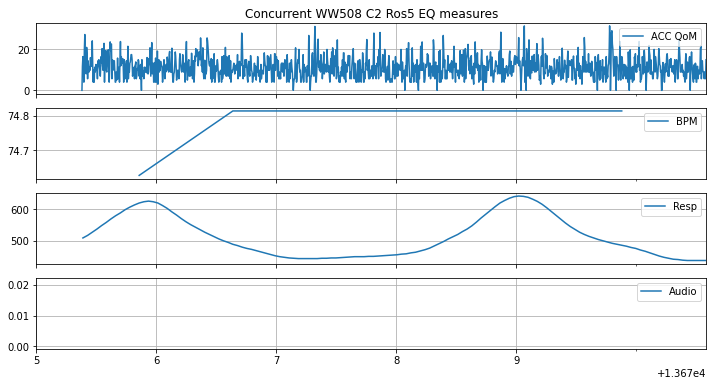

In [743]:
# plot all three
fig, axes = plt.subplots(4,1,figsize=(12,6),sharex = True)
time_c = 'rec_sTime'#
ax = axes[0]
V_seg = segs['ACC']
V_seg.plot(x=time_c,y='qom',label='ACC QoM',ax=ax)
ax.grid()
ax = axes[1]
V_seg = segs['Cardio']
V_seg.plot(x=time_c,y='HR_10bt',label='BPM',ax=ax)
ax.grid()
#V_seg.plot(x=time_c,y='Interbeat Interval (MS)',label='IBI',ax=ax)
ax = axes[2]
V_seg = segs['Resp']
V_seg.plot(x=time_c,y='Breathing',label='Resp',ax=ax)
ax.grid()
ax = axes[3]
aud_df.plot(y='rms',label='Audio',ax=ax)
ax.set_xlim([V_seg.iloc[0,0],V_seg.iloc[-1,0]])
ax.grid()
ax.set_xticks(np.arange(int(V_seg.iloc[0,0]),int(V_seg.iloc[-1,0])))
axes[0].set_title(' '.join(['Concurrent',partID,concert,segtag,'EQ measures']))
plt.savefig('_'.join(['./plots/','Concurrent',partID,concert,segtag,'check.png']),bbox_inches = 'tight',dpi = 200)

plt.show()

 ## find the tunning

In [213]:
concert = 'C3'
concert_start_dt = Event_timings.loc[concert,'dTime_start'] 
df_datafiles = eq.eq_recordings('/Volumes/TaeTae/Stavangar/bic2024/'+concert+'/','EQDATA','/') # 2024-03-06 10:19:23.800' + 24
data_dir = '/Volumes/TaeTae/Stavangar/bic2024/'+concert+'/'
time_c = 'c_sTime'#'rec_sTime'#
#M_times

In [249]:
concert = 'C1' #2024-03-06 08:34:57.517000000
# df_datafiles = eq.eq_recordings(data_dir+'20240306'+'/','EQDATA','/')
concert_start_dt = pd.to_datetime('2024-03-06 08:34:59.900000') # 2024-03-06 08:35:08.959900
data_dir = '/Volumes/TaeTae/Stavangar/bic2024/20240306/'
time_c = 'rec_sTime'#
# C1 concert start within 200 ms of '2024-03-06 08:34:59.900'

In [322]:
concert = 'C2' #2024-03-06 08:34:57.517000000
df_datafiles = eq.eq_recordings('/Volumes/TaeTae/Stavangar/bic2024/'+'wed'+'/','EQDATA','/') # 2024-03-06 10:19:23.800' + 24
data_dir ='/Volumes/TaeTae/Stavangar/bic2024/'+'wed'+'/'
concert_start_dt = pd.to_datetime('2024-03-06 10:19:47.90000') # '2024-03-06 10:14:53.800' '2024-03-06 10:15:02.685500000'
time_c = 'rec_sTime'#

# '2024-03-06 10:14:49.800' # '2024-03-06 10:15:31.100' # '2024-03-06 10:14:49.000' # '2024-03-06 10:15:12.200000'

In [323]:
C_times = Piece_timings[['Event','Event_Type','Related']].copy()
C_times['Start'] =  Piece_timings[concert]
C_times = C_times.sort_values('Start')
C_times['Next'] = C_times.Start.shift(-1)
C_times['Start_dt'] = concert_start_dt + pd.to_timedelta(C_times['Start'],unit='s')
C_times['Next_dt'] = concert_start_dt + pd.to_timedelta(C_times['Next'],unit='s')
M_times =  C_times.loc[C_times['Event_Type'] == 'Music',:]
M_times.set_index('Related',drop = True,inplace = True)

# M_times

In [324]:
buff = 1
buff_dt = pd.to_timedelta(1,unit='s')
segtag ='Ross'#'Newm'#'Conc'#'Ros5'#'Conc'#'Trad'#'Ross'# 'Trad'#'Stra'#'Newm'#'Conc'
time_start = M_times.loc[segtag,'Start_dt']-buff_dt+ pd.to_timedelta(0,unit='s')
# time_start = concert_start_dt + pd.to_timedelta(-1,unit='s')+M_times.loc[segtag,'Start_dt']
# time_end = concert_start_dt + pd.to_timedelta(1,unit='s')+M_times.loc[segtag,'Next_dt']+buff_dt
time_end = M_times.loc[segtag,'Next_dt']+ pd.to_timedelta(0,unit='s')+buff_dt
partID = 'WW508'
aud_file = audio_loc + '_'.join([concert,segtag,str(buff)+'.mp3'])
y, sr = librosa.load(aud_file)
rms =librosa.feature.rms(y=y, frame_length=256, hop_length=64, center=True, pad_mode='constant')
times = librosa.times_like(rms,sr = sr, hop_length=64)
rms_sf = int(sr/64)
aud_df = pd.DataFrame(index = times + M_times.loc[segtag,'Start'])
aud_df['rms'] = rms[0]
Audio(data=y, rate=sr)

In [315]:


concert = 'WTOrate1' #2024-03-06 08:34:57.517000000
df_datafiles = eq.eq_recordings('/Volumes/TaeTae/Stavangar/bic2024/'+'wed'+'/','EQDATA','/') # 2024-03-06 10:19:23.800' + 24
data_dir ='/Volumes/TaeTae/Stavangar/bic2024/'+'wed'+'/'
concert_start_dt = pd.to_datetime('2024-03-06 11:16:51.240000') # '2024-03-06 10:14:53.800' '2024-03-06 10:15:02.685500000'
time_c = 'rec_sTime'#

# '2024-03-06 10:14:49.800' # '2024-03-06 10:15:31.100' # '2024-03-06 10:14:49.000' # '2024-03-06 10:15:12.200000'

In [316]:


buff = 1
buff_dt = pd.to_timedelta(1,unit='s')
segtag ='Ross'#'Newm'#'Conc'#'Ros5'#'Conc'#'Trad'#'Ross'# 'Trad'#'Stra'#'Newm'#'Conc'
time_start = concert_start_dt-buff_dt
time_end = concert_start_dt+buff_dt+ pd.to_timedelta(396,unit='s')
partID = 'WW508'
aud_file = audio_loc + '_'.join(['C2',segtag,str(buff)+'.mp3'])
y, sr = librosa.load(aud_file)
rms =librosa.feature.rms(y=y, frame_length=256, hop_length=64, center=True, pad_mode='constant')
times = librosa.times_like(rms,sr = sr, hop_length=64)
rms_sf = int(sr/64)
aud_df = pd.DataFrame(index = times + M_times.loc[segtag,'Start'])
aud_df['rms'] = rms[0]
Audio(data=y, rate=sr)

In [325]:
# data_dir = '/Volumes/TaeTae/Stavangar/bic2024/wed/'
partID = 'WW508'
print([partID,time_start,time_end])
segs = phys_cut(data_dir ,partID,time_start,time_end,time_c) #'wed'+'/'
# plot all three
# ['WW508', Timestamp('2024-03-06 11:05:33.338000'), Timestamp('2024-03-06 11:12:11.704000')]


['WW508', Timestamp('2024-03-06 11:05:33.338000'), Timestamp('2024-03-06 11:12:11.704000')]
5


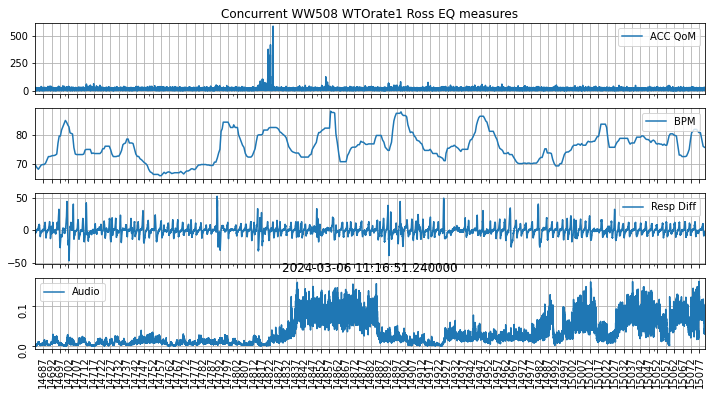

In [318]:
fig, axes = plt.subplots(4,1,figsize=(12,6),sharex = True)
ax = axes[0]
V_seg = segs['ACC'].copy()
V_seg.plot(x=time_c,y='qom',label='ACC QoM',ax=ax)
ax.grid()
ax = axes[1]
V_seg = segs['Cardio'].copy()
V_seg.plot(x=time_c,y='HR_10bt',label='BPM',ax=ax)
ax.grid()
#V_seg.plot(x=time_c,y='Interbeat Interval (MS)',label='IBI',ax=ax)
ax = axes[2]
V_seg = segs['Resp'].copy()
V_seg['BreathDiff'] = V_seg['Breathing'].diff()#-V_seg['Breathing'].mean()#.diff()#
V_seg.plot(x=time_c,y='BreathDiff',label='Resp Diff',ax=ax)
ax.grid()

time0 = V_seg[time_c].iloc[0]
ax = axes[3]
aud_df2 = aud_df.copy()
aud_df2.index = aud_df.index - aud_df.index[0] + time0
aud_df2.plot(y='rms',label='Audio',ax=ax)
ax.set_title(concert_start_dt)

xrange = [V_seg.iloc[0,0],V_seg.iloc[-1,0]]
ax.set_xticks(np.arange(int(V_seg.iloc[0,0]),int(V_seg.iloc[-1,0]),5))
ax.tick_params(labelrotation = 90)
ax.set_xlim(xrange)
ax.grid()
axes[0].set_title(' '.join(['Concurrent',partID,concert,segtag,'EQ measures']))
plt.savefig('_'.join(['./plots/Concurrent',partID,concert,segtag,'4check.png']),bbox_inches = 'tight',dpi = 200)

plt.show()

In [320]:
xrange

[14812.6566, 14827.6566]

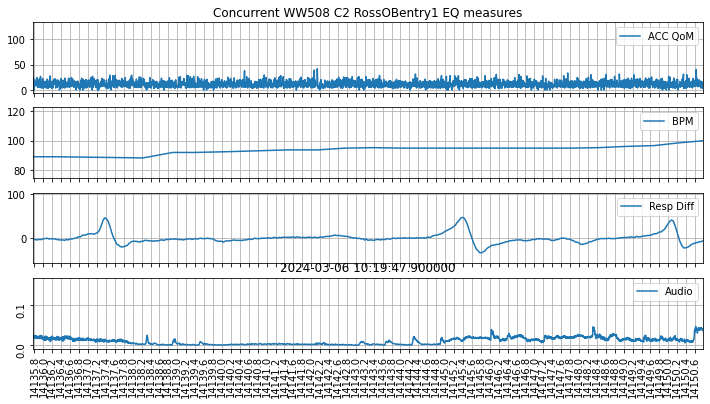

In [326]:

fig, axes = plt.subplots(4,1,figsize=(12,6),sharex = True)
ax = axes[0]
V_seg = segs['ACC'].copy()
V_seg.plot(x=time_c,y='qom',label='ACC QoM',ax=ax)
ax.grid()
ax = axes[1]
V_seg = segs['Cardio'].copy()
V_seg.plot(x=time_c,y='HR_10bt',label='BPM',ax=ax)
ax.grid()
#V_seg.plot(x=time_c,y='Interbeat Interval (MS)',label='IBI',ax=ax)
ax = axes[2]
V_seg = segs['Resp'].copy()
V_seg['BreathDiff'] = V_seg['Breathing'].diff()#-V_seg['Breathing'].mean()#.diff()#
V_seg.plot(x=time_c,y='BreathDiff',label='Resp Diff',ax=ax)
ax.grid()

time0 = V_seg[time_c].iloc[0]
ax = axes[3]
aud_df2 = aud_df.copy()
aud_df2.index = aud_df.index - aud_df.index[0] + time0
aud_df2.plot(y='rms',label='Audio',ax=ax)
ax.set_title(concert_start_dt)

segtag = 'RossOBentry1'
evt = 132.9
# segtag = 'RossEHentry1' # 243.68 
# evt = 243.7 
# segtag = 'RossEHerror' 
# evt = 251.9 
# xrange = [V_seg.iloc[0,0]+evt-2.5,V_seg.iloc[0,0]+evt+2.5]
xrange = [V_seg.iloc[0,0]+evt-2.5,V_seg.iloc[0,0]+evt+12.5]
ax.set_xticks(np.arange(int(V_seg.iloc[0,0]),int(V_seg.iloc[-1,0]),0.2))
ax.tick_params(labelrotation = 90)
ax.set_xlim(xrange)
ax.grid()
axes[0].set_title(' '.join(['Concurrent',partID,concert,segtag,'EQ measures']))
plt.savefig('_'.join(['./plots/Concurrent',partID,concert,segtag,'4check.png']),bbox_inches = 'tight',dpi = 200)

plt.show()

30
30


ParserError: Error tokenizing data. C error: Calling read(nbytes) on source failed. Try engine='python'.

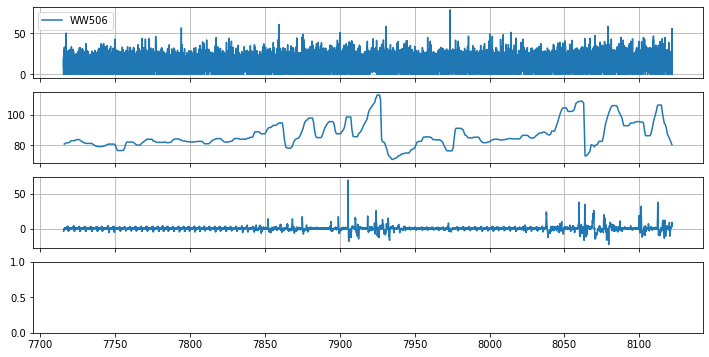

In [254]:
# plot all three
# segtag = 'Newm'
fig, axes = plt.subplots(4,1,figsize=(12,6),sharex = True)
for pid in df_datafiles['PartID']:
    segs = phys_cut(data_dir,pid,time_start,time_end,time_c) #+'wed'+'/'

    ax = axes[0]
    V_seg = segs['ACC']
    V_seg.plot(x=time_c,y='qom',label=pid,ax=ax)
    ax.grid()
    ax = axes[1]
    V_seg = segs['Cardio']
    V_seg.plot(x=time_c,y='HR_10bt',ax=ax,legend = False) #label=pid,
    ax.grid()
    #V_seg.plot(x=time_c,y='Interbeat Interval (MS)',label='IBI',ax=ax)
    ax = axes[2]
    V_seg = segs['Resp']
    V_seg['Breathing'] = V_seg['Breathing'].diff()#-V_seg['Breathing'].median() #.diff()#
    V_seg.plot(x=time_c,y='Breathing',ax=ax,legend = False)# label=pid,
    ax.grid()
# ax.legend()
time0 = V_seg[time_c].iloc[0]
ax = axes[3]
aud_df.index = aud_df.index - aud_df.index[0] + time0
aud_df.plot(y='rms',label='Audio',ax=ax)
ax.set_title(concert_start_dt)
ax.set_xlim([V_seg.iloc[0,0]+130,V_seg.iloc[0,0]+135])
# ax.set_xlim([V_seg.iloc[0,0],V_seg.iloc[-1,0]])
ax.grid()
ax.set_xticks(np.arange(int(V_seg.iloc[0,0]),int(V_seg.iloc[-1,0]),0.1))
axes[0].set_title(' '.join(['Concurrent',partID,concert,segtag,'EQ measures']))
plt.savefig('_'.join(['./plots/Concurrent',concert,segtag,'check.png']),bbox_inches = 'tight',dpi = 200)

plt.show()

In [145]:
data_dir = '/Volumes/TaeTae/Stavangar/bic2024/wed/'
partID = 'WW508'
print([partID,time_start,time_end])
segs = phys_cut(data_dir ,partID,time_start,time_end,'rec_sTime') #'wed'+'/'

['WW508', Timestamp('2024-03-06 10:19:57'), Timestamp('2024-03-06 10:21:09.868000')]
/Volumes/TaeTae/Stavangar/bic2024/wed/WW506_20240306_FULL_EQDATA.csv
/Volumes/TaeTae/Stavangar/bic2024/wed/WW508_20240306_FULL_EQDATA.csv
/Volumes/TaeTae/Stavangar/bic2024/wed/BR604_20240306_FULL_EQDATA.csv
/Volumes/TaeTae/Stavangar/bic2024/wed/BR609_20240306_FULL_EQDATA.csv
/Volumes/TaeTae/Stavangar/bic2024/wed/BR608_20240306_FULL_EQDATA.csv
5


In [725]:
A = segs['Resp'].copy()

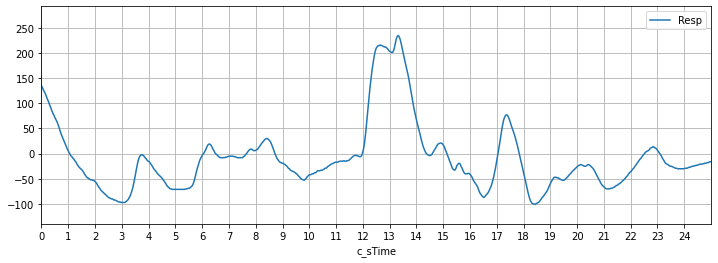

In [726]:
A['c_sTime'] = A.loc[:,'rec_sTime'] - A.iloc[0,0]
A.plot(x='c_sTime',y='Breathing',label='Resp', figsize=[12,4])
plt.xticks(np.arange(0,25))
plt.xlim([0,25])
plt.grid()
plt.show()

In [663]:
print(concert_start_dt)

2024-03-06 10:15:31.100000


In [595]:
A.iloc[0:50,:]
# A.iloc[210:250,:]

,rec_sTime,Breathing,rec_dTime,dev_dTime,c_sTime
293277,10973.3184,484,2024-03-06 10:15:01.318400000,2024-03-06 10:15:00.183,0.0000
293278,10973.3574,485,2024-03-06 10:15:01.357400000,2024-03-06 10:15:00.222,0.0390
293279,10973.3964,485,2024-03-06 10:15:01.396400000,2024-03-06 10:15:00.261,0.0780
293280,10973.4354,486,2024-03-06 10:15:01.435400000,2024-03-06 10:15:00.300,0.1170
293281,10973.4744,486,2024-03-06 10:15:01.474400000,2024-03-06 10:15:00.339,0.1560
293282,10973.5134,487,2024-03-06 10:15:01.513399999,2024-03-06 10:15:00.378,0.1950
293283,10973.5524,488,2024-03-06 10:15:01.552400000,2024-03-06 10:15:00.417,0.2340
293284,10973.5914,488,2024-03-06 10:15:01.591400000,2024-03-06 10:15:00.456,0.2730
293285,10973.6314,489,2024-03-06 10:15:01.631400000,2024-03-06 10:15:00.496,0.3130
293286,10973.6704,490,2024-03-06 10:15:01.670400000,2024-03-06 10:15:00.535,0.3520


# full orch line up phys


In [ ]:
concert = 'C3'

In [48]:
data_dir='/Volumes/TaeTae/Stavangar/bic2024/'
sep = '/'
DATAtag='EQDATA'
df_datafiles = eq.eq_recordings(data_dir+concert+'/','EQDATA','/')
#df_datafiles.iloc[:5,:]

In [49]:
concert_start_dt = Event_timings.loc[concert,'dTime_start'] 
C_times = Piece_timings[['Event','Event_Type','Related']].copy()
C_times['Start'] =  Piece_timings[concert]
C_times = C_times.sort_values('Start')
C_times['Next'] = C_times.Start.shift(-1)
C_times['Start_dt'] = concert_start_dt + pd.to_timedelta(C_times['Start'],unit='s')
C_times['Next_dt'] = concert_start_dt + pd.to_timedelta(C_times['Next'],unit='s')
M_times =  C_times.loc[C_times['Event_Type'] == 'Music',:]
M_times.set_index('Related',drop = True,inplace = True)
# M_times

In [132]:
data_dir='/Volumes/TaeTae/Stavangar/bic2024'
Show_folder = {
    'RD':data_dir + '/RD/',
    'C1':data_dir + '/C1/',
    'C2':data_dir + '/C2/',
    'C3':data_dir + '/C3/',
    'C4':data_dir + '/C4/',
    'C5':data_dir + '/C5/',
    'C6':data_dir + '/C6/',
    'C7':data_dir + '/C7/'}

# concerts = list(concert_loc.keys())
concerts =['RD', 'C3', 'C4', 'C5', 'C6', 'C7']

In [138]:
Piece_timings.loc[1:20,:]

,Event,Related,Event_Type,Full_Title,Composer,Performer,Screen,RD,C1,C2,C3,C4,C5,C6,C7
1,Marsj,Trad,Music,Gammel Jegermarsj,arr. Frederik Schöildberg (?),NaN,NaN,589.203333,45.320000,41.868,46.013333,42.478500,48.032000,41.860000,43.392000
2,MC,Trad,Speech,NaN,NaN,NaN,NaN,606.933333,63.086667,59.780,64.253333,60.690000,65.960000,59.901333,61.077333
3,Ringe,Intr,Music,NaN,NaN,NaN,NaN,612.912000,77.263333,88.020,76.248667,74.331000,79.840000,73.653333,75.242667
4,MC,Intr,Speech,NaN,NaN,NaN,NaN,615.216000,82.033333,93.982,81.013333,79.189333,85.168000,77.888000,79.914667
5,Applause,Intr,Applause,NaN,NaN,NaN,NaN,646.440000,112.403333,125.524,117.917333,110.641500,117.080000,109.568000,112.372000
6,MC,Intr,Speech,NaN,NaN,NaN,NaN,652.776000,123.643333,141.732,129.649333,122.877000,128.384000,120.213333,124.744000
7,20thCFox,Newm,Music,Fanfar (20th Cent. Fox),Alfred Newman,NaN,NaN,669.048000,138.070000,159.230,143.038000,136.741500,139.304000,137.330000,158.080000
8,Applause,Newm,Applause,NaN,NaN,NaN,NaN,NaN,NaN,181.344,NaN,159.645000,162.133333,158.246667,181.748000
9,MC,Gre1,Speech,NaN,NaN,NaN,NaN,691.533333,162.713333,181.526,165.111333,163.492500,167.752000,165.023333,187.904000
10,Morgenstemning,Gre1,Music,"Peer Gynt Suite No. 1, Op. 46 i Morgenstemning",Edvard Grieg,NaN,Preikestolen,715.133333,191.280000,209.216,193.410000,192.756000,193.880000,195.040000,214.896000


In [111]:
# Piece_timings = pd.read_csv('./Timing/ctimes.csv')
Piece_timings.iloc[[1,2],:] 
# use Strauss excerpt across pieces to demonstrate alignment quality across conditions
# 1. close to alignment point or far, 
# 2. recording specific estimate of drift or device median

,Event,Related,Event_Type,Full_Title,Composer,Performer,Screen,RD,C1,C2,C3,C4,C5,C6,C7
1,Marsj,Trad,Music,Gammel Jegermarsj,arr. Frederik Schöildberg (?),NaN,NaN,589.203333,45.320000,41.868,46.013333,42.4785,48.032,41.860000,43.392000
2,MC,Trad,Speech,NaN,NaN,NaN,NaN,606.933333,63.086667,59.780,64.253333,60.6900,65.960,59.901333,61.077333


In [95]:
df_datafiles['PartID'].values

array(['WW506', 'WW508', 'BR604', 'BR608', 'BR609'], dtype=object)

In [96]:
player_order = ['VN104','VN109', 'VN110','VN111','VN201','VN212',
                'VN101','VN105','VN206','VN211',
                'VA304','VA305', 'VA309', 
                'LS401','LS405', 'LS407',
                'LS404','LS409','LS410',
                'WW504','WW506', 'WW508',
                'BR604','BR609','BR605','BR606','BR608',
                'PC709','PC702','PC710']

In [ ]:
# C2 isn't close to the right time. try longer xcerpt, like 5 minutes

In [139]:
Performances = {}
piece_name = 'EndKjempe'
datafile_type = 'EQBACC'
sigName = 'QoM'
# player_order
for concert in Show_folder.keys():
    print(concert)
    data_loc = Show_folder[concert]
    files = os.listdir(data_loc)
    files.sort()
    sig_files = {}
    for f in files: 
        if f.endswith(datafile_type+'.csv'): 
            partID = f.split('_')[2]
            sig_files[partID] = data_loc+f
            
    sf = 50 # hz # 50
    s_time = Piece_timings.loc[19,concert]-30
    e_time =  Piece_timings.loc[19,concert]+20
    dur = e_time - s_time
    time_s = s_time +  np.round(np.linspace(0,dur,int(sf*(dur)),endpoint=False),3)
    df_seg = pd.DataFrame(index = time_s, columns = player_order)
    
    df_sig = pd.DataFrame(index = time_s,columns = player_order,dtype='float') # Piece_timings.loc[2,ev]
    # ACC
    for partID in sig_files.keys(): #['c_sTime']
        V = pd.read_csv(sig_files[partID])
        sig_t = V['c_sTime']
        if sigName == 'QoM':
            sig_v = np.sqrt(np.square(V.loc[:,[ 'Vert Accelerometer','Lat Accelerometer','Long Accelerometer']].diff()).sum(axis=1))
        else:
            if sigName in V.columns:
                sig_v = V[sigName].values

        f = interpolate.interp1d(sig_t, sig_v,fill_value='extrapolate')
        new_sig = f(time_s)
        df_sig.loc[:,partID] = new_sig
        
    Performances[concert] = df_sig.copy()

RD
C1
C2
C3
C4
C5
C6
C7


In [133]:
#Performances = {}
piece_name = 'Marsj'
datafile_type = 'EQBACC'
sigName = 'QoM'
# player_order
concert = 'C2'
data_loc = Show_folder[concert]
files = os.listdir(data_loc)
files.sort()
sig_files = {}
for f in files: 
    if f.endswith(datafile_type+'.csv'): 
        partID = f.split('_')[2]
        sig_files[partID] = data_loc+f

sf = 20 # hz # 50
s_time = Piece_timings.loc[1,concert]-30
e_time =  Piece_timings.loc[1,concert]+1830
dur = e_time - s_time
time_s = s_time +  np.round(np.linspace(0,dur,int(sf*(dur)),endpoint=False),3)
df_seg = pd.DataFrame(index = time_s, columns = player_order)

df_sig = pd.DataFrame(index = time_s,columns = player_order,dtype='float') # Piece_timings.loc[2,ev]
# ACC
for partID in sig_files.keys(): #['c_sTime']
    V = pd.read_csv(sig_files[partID])
    sig_t = V['c_sTime']
    if sigName == 'QoM':
        sig_v = np.sqrt(np.square(V.loc[:,[ 'Vert Accelerometer','Lat Accelerometer','Long Accelerometer']].diff()).sum(axis=1))
    else:
        if sigName in V.columns:
            sig_v = V[sigName].values

    f = interpolate.interp1d(sig_t, sig_v,fill_value='extrapolate')
    new_sig = f(time_s)
    df_sig.loc[:,partID] = new_sig

Performances[concert] = df_sig.copy()

In [134]:
piece_name = 'Marsj2'


In [136]:
Piece_timings.loc[7,concert]

158.08

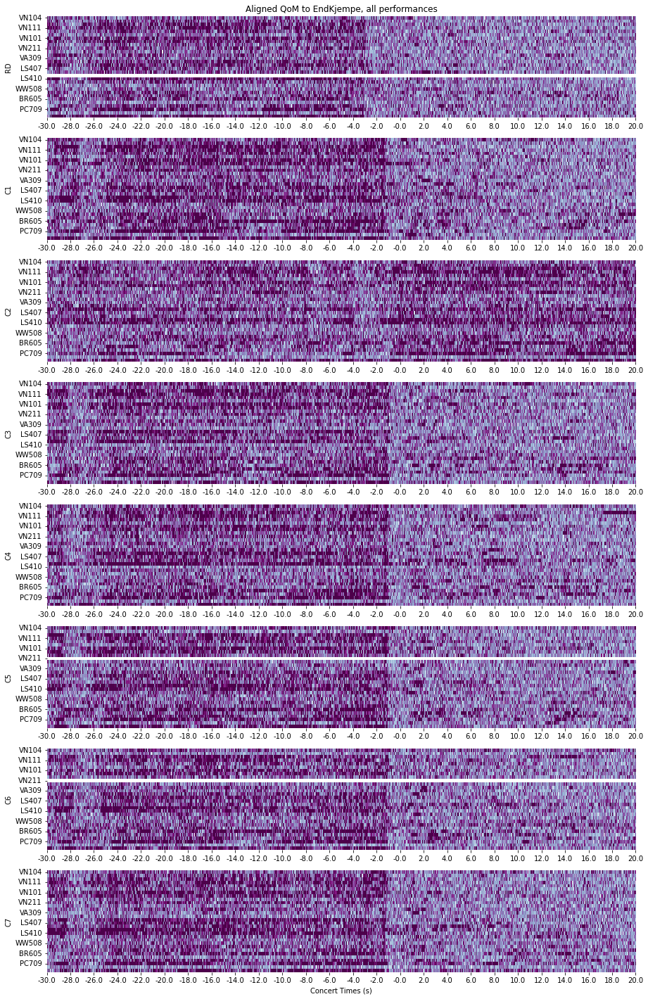

In [140]:
concerts = list(Performances.keys())
fig, (ax) = plt.subplots(len(concerts), 1,figsize = [15,25])
for i in range(len(concerts)):
    concert = concerts[i]
    df_sig = Performances[concert].copy()
    times = df_sig.index-Piece_timings.loc[19,concert]
    num_ticks = 26
    xticks = np.linspace(0, len(times) - 1, num_ticks, dtype='int')
    xticklabels = [np.round(times[idx],1) for idx in xticks]

    chart = sns.heatmap(data=df_sig[player_order].transpose(), ax=ax[i],vmin=0, vmax=20, cbar=False,cmap="BuPu")
    ax[i].set_xticks(xticks)
    ax[i].set_xticklabels(xticklabels,rotation = 0)
    ax[i].set_ylabel(concert)
    if i == 0:
        ax[i].set_title('Aligned ' +  sigName + ' to ' + piece_name + ', all performances')

ax[i].set_xlabel('Concert Times (s)')
plt.savefig('./plots/All_performances_'+ piece_name+ '_set_'+sigName+'.png',dpi = 300)
plt.show()
